## BƯỚC 2: XÂY DỰNG MÔ HÌNH XẾP HẠNG CV TỰ ĐỘNG 

In [1]:
import pandas as pd
import numpy as np
import re
import nltk
from nltk.corpus import stopwords
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, classification_report
import spacy
import pickle
from sentence_transformers import SentenceTransformer
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
from torch.cuda.amp import autocast, GradScaler
from sklearn.linear_model import LinearRegression
import xgboost as xgb
import matplotlib.pyplot as plt
from scipy import stats
import gc
import logging
import time
import os

In [2]:
# Thiết lập logging
logging.basicConfig(
    filename='D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/training_log.txt',
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)

In [3]:
# Tải file dataset đã xử lý ở bước 1
labeled_data = pd.read_csv('D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/datasets/labeled_dataset.csv')

In [4]:
# Hiển thị 5 dòng đầu để kiểm tra
labeled_data.head()

,CV_text,JD_text,avg_score
0,office staff database administrator office sta...,aw metering bill generation combine interestin...,24.888178
1,reactjs developer reactjs span ldeveloperspan ...,job 4 - 10 year experience full stack developm...,36.744110
2,jim ryan software developer 917 202 - 5269 new...,"web developer html , css , javascript commutab...",49.052204
3,vpn project consultant silgan container vpn pr...,job title software development director locati...,39.674040
4,principal clientserver op analyst principal cl...,"job key skill requirement experience install ,...",42.988987


In [5]:
# lấy danh sách các cột (tên cột) của labeled_data
labeled_data.columns

Index(['CV_text', 'JD_text', 'avg_score'], dtype='object')

In [6]:
print('Độ dài của cv_df là: ', len(labeled_data))

Độ dài của cv_df là:  19549


In [7]:
# hiển thị số hàng và cột của labeled_data
labeled_data.shape

(19549, 3)

In [8]:
# hiển thị thông tin tổng quan labeled_data
labeled_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19549 entries, 0 to 19548
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   CV_text    19549 non-null  object 
 1   JD_text    19549 non-null  object 
 2   avg_score  19549 non-null  float64
dtypes: float64(1), object(2)
memory usage: 458.3+ KB


In [9]:
# hiển thị kiểu dữ liệu (data type) của từng cột trong labeled_data
labeled_data.dtypes

CV_text       object
JD_text       object
avg_score    float64
dtype: object

In [10]:
# kiểm tra xem có giá trị null trong dataframe ko?
np.sum(labeled_data.isnull().any(axis=1))

0

In [11]:
# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\tgdd\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tgdd\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


True

In [12]:
# Load Spacy model for NER
nlp = spacy.load("en_core_web_sm")

In [13]:
# Trích xuất văn bản và điểm số
cv_texts = labeled_data['CV_text'].tolist()
jd_texts = labeled_data['JD_text'].tolist()
avg_scores = labeled_data['avg_score'].values

In [14]:
# Kết hợp làm sạch văn bản và trích xuất tính năng NER
stop_words = set(stopwords.words('english'))
def preprocess_and_extract_features(text):
    """
    Xử lý văn bản và trích xuất thông tin kỹ năng, kinh nghiệm, học vấn cho ngành CNTT
    Tự động điều chỉnh phạm vi quét theo độ dài văn bản
    """
    # Tiền xử lý cơ bản
    text = text.lower()
    text = re.sub(r'\S+@\S+', ' ', text)  # Remove emails
    text = re.sub(r'http\S+|www\S+', ' ', text)  # Remove URLs
    text = re.sub(r'\b\d{3}[-.\s]?\d{3}[-.\s]?\d{4}\b', ' ', text)  # Remove phone numbers
    text = ''.join([char for char in text if char.isalnum() or char.isspace() or char in [',', '.', '-']])
    text = re.sub(r'\s+', ' ', text).strip()
    
    # Chuẩn hóa thuật ngữ CNTT
    replacements = {
        r'\b(yrs?|years?)\b': 'years',
        r'\b(exp|experience)\b': 'experience',
        r'\b(edu|education)\b': 'education',
        r'\b(prog|programming)\b': 'programming',
        r'\b(dev|developer)\b': 'developer',
        r'\b(eng|engineer)\b': 'engineer',
        r'\b(c#|csharp)\b': 'c#',
        r'\b(js|javascript)\b': 'javascript',
        r'\b(py|python)\b': 'python'
    }
    for pattern, repl in replacements.items():
        text = re.sub(pattern, repl, text)
    
    # Từ điển keyword cho ngành CNTT
    it_skill_keywords = [
    # Các phần header thông thường
    'skills', 'technical skills', 'technical competencies', 'key skills',
    'core competencies', 'technical expertise', 'skill set', 'skill summary',
    'programming skills', 'technical abilities', 'professional skills',
    
    # Các cách diễn đạt về kỹ năng
    'proficient in', 'experienced in', 'knowledge of', 'expertise in',
    'skilled in', 'familiar with', 'competent in', 'adept at', 
    'strong background in', 'hands-on experience with', 'working knowledge of',
    
    # Các loại kỹ năng cụ thể
    'programming languages', 'frameworks', 'tools', 'libraries',
    'platforms', 'databases', 'cloud technologies', 'devops tools',
    'frontend technologies', 'backend technologies', 'fullstack technologies',
    'mobile development', 'ai/ml technologies', 'data science tools',
    'cybersecurity skills', 'networking knowledge', 'operating systems',
    'version control systems', 'ci/cd tools', 'containerization',
    'testing frameworks', 'debugging tools', 'ide experience',
    
    # Các kỹ năng mềm liên quan
    'problem solving', 'algorithm design', 'system architecture',
    'code optimization', 'performance tuning', 'security practices',
    'agile methodologies', 'code review', 'technical documentation'
]

    it_experience_keywords = [
    # Các phần header thông thường
    'experience', 'work experience', 'professional experience',
    'employment history', 'career history', 'work background',
    'professional background', 'relevant experience',
    
    # Các cách diễn đạt về kinh nghiệm
    'worked as', 'served as', 'held position as', 'acted as',
    'years of experience', 'hands-on experience', 'it experience',
    'technical experience', 'industry experience', 'practical experience',
    
    # Các hoạt động công việc
    'projects', 'implemented', 'developed', 'deployed', 'architected',
    'engineered', 'designed', 'built', 'created', 'maintained',
    'optimized', 'debugged', 'tested', 'documented', 'led',
    'managed', 'coordinated', 'collaborated on', 'contributed to',
    
    # Các mức độ kinh nghiệm
    'junior', 'senior', 'lead', 'principal', 'architect', 'manager',
    'director', 'team lead', 'technical lead', 'subject matter expert',
    
    # Các loại kinh nghiệm cụ thể
    'full-time', 'part-time', 'contract', 'freelance', 'internship',
    'volunteer'
]

    it_education_keywords = [
    # Các phần header thông thường
    'education', 'academic background', 'qualifications',
    'degrees', 'certifications', 'academic credentials',
    'educational background', 'training', 'courses',
    
    # Các loại tổ chức giáo dục
    'university', 'college', 'institute', 'school', 'academy',
    'polytechnic', 'technical school', 'bootcamp', 'online course',
    
    # Các bằng cấp
    'bachelor', "bachelor's", 'bsc', 'bs', 'b.eng', 'b.tech',
    'master', "master's", 'msc', 'ms', 'm.eng', 'm.tech',
    'phd', 'ph.d', 'doctorate', 'postdoc', 'postdoctoral',
    'diploma', 'certificate', 'associate degree',
    
    # Các chuyên ngành CNTT
    'computer science', 'information technology', 'software engineering',
    'data science', 'computer engineering', 'it', 'cybersecurity',
    'network engineering', 'artificial intelligence', 'machine learning',
    'computer systems', 'database systems', 'web development',
    'mobile development', 'cloud computing', 'devops',
    
    # Các khóa học và đào tạo
    'coursework', 'relevant courses', 'training programs',
    'professional development', 'certification programs',
    'online learning', 'moocs', 'workshops', 'seminars'
]
    
    # Tự động điều chỉnh phạm vi quét
    text_length = len(text)
    base_range = min(1000, max(300, int(text_length * 0.3)))  # Từ 300-1000 ký tự
    
    scan_ranges = {
        'skills': base_range * 1.5,  # Ưu tiên quét rộng hơn cho kỹ năng
        'experience': base_range,
        'education': base_range
    }
    
    # Hàm quét thông minh
    def smart_scan(content, keyword, scan_range):
        pos = content.find(keyword)
        if pos == -1:
            return ""
    
        start = max(0, pos - 50)  # Quét ngược 50 ký tự
        end = min(len(content), start + int(scan_range))  # Ensure scan_range is integer
    
        # Ưu tiên lấy đến hết section nếu có dấu phân cách
        next_section = re.search(r'\n\s*\n', content[int(pos):int(end)])  # Convert to integers
        if next_section:
            end = pos + next_section.start()
    
        return content[int(start):int(end)].strip()  # Ensure integer indices
    
    # Trích xuất thông tin
    skills = set()
    experience = set()
    education = set()
    
    # 1. Trích xuất kỹ năng CNTT
    for keyword in it_skill_keywords:
        section = smart_scan(text, keyword, scan_ranges['skills'])
        if section:
            # Trích xuất từ danh sách
            skill_items = re.split(r'[,•\-–;()\n/]', section)
            for item in skill_items:
                item = item.strip()
                if 2 <= len(item) <= 50:  # Độ dài hợp lý
                    skills.add(item.title())
            
            # Trích xuất bằng NER
            doc = nlp(section)
            for ent in doc.ents:
                if ent.label_ in ['ORG', 'PRODUCT'] and any(char.isalpha() for char in ent.text):
                    skills.add(ent.text.title())
    
    # 2. Trích xuất kinh nghiệm
    for keyword in it_experience_keywords:
        section = smart_scan(text, keyword, scan_ranges['experience'])
        if section:
            # Số năm kinh nghiệm
            years_exp = re.findall(
                r'(\d+)\s*(?:\+)?\s*(?:years?|yrs?)(?:\s*(?:of|in)\s*(?:experience|exp))?', 
                section
            )
            for year in years_exp:
                experience.add(f"{year} years experience")
            
            # Vị trí công việc
            job_titles = re.findall(
                r'(?:senior|junior|lead|principal)?\s*'
                r'(?:software|it|data|devops|cloud|systems)?\s*'
                r'(?:engineer|developer|architect|analyst|specialist)', 
                section
            )
            for title in job_titles:
                experience.add(title.title())
    
    # 3. Trích xuất học vấn
    for keyword in it_education_keywords:
        section = smart_scan(text, keyword, scan_ranges['education'])
        if section:
            # Bằng cấp
            degrees = re.findall(
                r'(bsc|b\.?sc|bachelor|bs|b\.?s|'
                r'msc|m\.?sc|master|ms|m\.?s|'
                r'phd|ph\.?d|doctorate)\b', 
                section, flags=re.IGNORECASE
            )
            for degree in degrees:
                education.add(degree.title())
            
            # Tên trường
            doc = nlp(section)
            for ent in doc.ents:
                if ent.label_ == 'ORG' and any(w in ent.text.lower() for w in ['university', 'college', 'institute']):
                    education.add(ent.text.title())
    
    # Làm sạch kết quả
    def clean_items(items):
        cleaned = set()
        for item in items:
            item = re.sub(r'[^\w\s\-\.#+]', '', item)  # Loại bỏ ký tự đặc biệt
            item = item.strip()
            if item and not item.isdigit():
                cleaned.add(item)
        return sorted(cleaned)
    
    return {
        'cleaned_text': ' '.join([token.lemma_ for token in nlp(text) if token.text not in stop_words]),
        'features': {
            'skills': clean_items(skills),
            'experience': clean_items(experience),
            'education': clean_items(education)
        }
    }

In [15]:
# Áp dụng tiền xử lý và trích xuất tính năng cho CV và JD
cv_results = [preprocess_and_extract_features(text) for text in cv_texts]
jd_results = [preprocess_and_extract_features(text) for text in jd_texts]

In [16]:
# Trích xuất các văn bản và tính năng đã được làm sạch
cv_texts = [result['cleaned_text'] for result in cv_results]
jd_texts = [result['cleaned_text'] for result in jd_results]
cv_features = [result['features'] for result in cv_results]
jd_features = [result['features'] for result in jd_results]

In [17]:
# Chuẩn hóa các thuật ngữ phổ biến
def normalize_terms(text):
    # Chuyển đổi văn bản thành chữ thường để khớp không phân biệt chữ hoa chữ thường
    text_lower = text.lower()
    
    # Từ điển thay thế mở rộng
    replacements = {
        # Ngôn ngữ lập trình
        'javascript': 'js',
        'java script': 'js',
        'python': 'py',
        'c plus plus': 'c++',
        'cplus plus': 'c++',
        'c plusplus': 'c++',
        'c#': 'csharp',
        'c sharp': 'csharp',
        'java': 'java',
        'ruby': 'ruby',
        'php': 'php',
        'go': 'go',
        'golang': 'go',
        'rust': 'rust',
        'kotlin': 'kotlin',
        'swift': 'swift',
        'typescript': 'ts',
        'scala': 'scala',
        'perl': 'perl',
        'r language': 'r',
        'r programming': 'r',
        'dart': 'dart',
        'lua': 'lua',
        'elixir': 'elixir',
        'erlang': 'erlang',
        'haskell': 'haskell',
        'clojure': 'clojure',
        'f#': 'fsharp',
        'f sharp': 'fsharp',
        'groovy': 'groovy',
        'matlab': 'matlab',
        'shell scripting': 'shell',
        'bash': 'bash',
        'powershell': 'powershell',
        
        # Khung và Thư viện
        'scikit-learn': 'sklearn',
        'scikit learn': 'sklearn',
        'tensorflow': 'tensorflow',
        'tensor flow': 'tensorflow',
        'pytorch': 'pytorch',
        'pandas': 'pandas',
        'numpy': 'numpy',
        'django': 'django',
        'flask': 'flask',
        'fastapi': 'fastapi',
        'spring': 'spring',
        'spring boot': 'springboot',
        'hibernate': 'hibernate',
        'asp.net': 'aspnet',
        'asp net': 'aspnet',
        'vb.net': 'vbnet',
        'vb net': 'vbnet',
        'j2ee': 'j2ee',
        'node.js': 'nodejs',
        'node js': 'nodejs',
        'react': 'react',
        'reactjs': 'react',
        'react.js': 'react',
        'angular': 'angular',
        'angularjs': 'angular',
        'vue.js': 'vuejs',
        'vuejs': 'vuejs',
        'vue js': 'vuejs',
        'express': 'express',
        'express.js': 'express',
        'laravel': 'laravel',
        'symfony': 'symfony',
        'rails': 'rails',
        'ruby on rails': 'rails',
        'next.js': 'nextjs',
        'nextjs': 'nextjs',
        'nuxt.js': 'nuxtjs',
        'nuxtjs': 'nuxtjs',
        'svelte': 'svelte',
        'sveltekit': 'sveltekit',
        'meteor': 'meteor',
        'backbone.js': 'backbonejs',
        'ember.js': 'emberjs',
        'jquery': 'jquery',
        'bootstrap': 'bootstrap',
        'tailwind css': 'tailwind',
        'material ui': 'mui',
        'ant design': 'antd',
        
        # Công cụ và Môi trường phát triển
        'visual studio': 'vs',
        'visual studio code': 'vscode',
        'vs code': 'vscode',
        'intellij': 'intellij',
        'intellij idea': 'intellij',
        'eclipse': 'eclipse',
        'pycharm': 'pycharm',
        'webstorm': 'webstorm',
        'rubymine': 'rubymine',
        'android studio': 'androidstudio',
        'xcode': 'xcode',
        'jupyter': 'jupyter',
        'jupyter notebook': 'jupyter',
        'jupyter lab': 'jupyterlab',
        'git': 'git',
        'github': 'github',
        'gitlab': 'gitlab',
        'bitbucket': 'bitbucket',
        'svn': 'svn',
        'mercurial': 'mercurial',
        'npm': 'npm',
        'yarn': 'yarn',
        'pnpm': 'pnpm',
        'maven': 'maven',
        'gradle': 'gradle',
        'ant': 'ant',
        'cmake': 'cmake',
        'make': 'make',
        
        # Databases
        'mysql': 'mysql',
        'sql server': 'sqlserver',
        'microsoft sql server': 'sqlserver',
        'ms sql server': 'sqlserver',
        'postgresql': 'postgres',
        'postgres': 'postgres',
        'oracle': 'oracle',
        'mongodb': 'mongodb',
        'redis': 'redis',
        'cassandra': 'cassandra',
        'dynamodb': 'dynamodb',
        'sqlite': 'sqlite',
        'mariadb': 'mariadb',
        'couchdb': 'couchdb',
        'neo4j': 'neo4j',
        'influxdb': 'influxdb',
        'rethinkdb': 'rethinkdb',
        'nosql': 'nosql',
        'elasticsearch': 'elasticsearch',
        'elastic search': 'elasticsearch',
        'opensearch': 'opensearch',
        
        # Artificial Intelligence and Machine Learning
        'machine learning': 'ml',
        'deep learning': 'dl',
        'natural language processing': 'nlp',
        'computer vision': 'cv',
        'support vector machine': 'svm',
        'k nearest neighbors': 'knn',
        'k-nearest neighbors': 'knn',
        'principal component analysis': 'pca',
        'random forest': 'rf',
        'decision tree': 'dt',
        'naive bayes': 'nb',
        'naïve bayes': 'nb',
        'gradient boosting': 'gb',
        'xgboost': 'xgboost',
        'lightgbm': 'lightgbm',
        'catboost': 'catboost',
        'yolo': 'yolo',
        'convolutional neural network': 'cnn',
        'recurrent neural network': 'rnn',
        'long short term memory': 'lstm',
        'gated recurrent unit': 'gru',
        'transformer': 'transformer',
        'bert': 'bert',
        'gpt': 'gpt',
        't5': 't5',
        'roberta': 'roberta',
        'llama': 'llama',
        'mistral': 'mistral',
        'generative ai': 'genai',
        'reinforcement learning': 'rl',
        'federated learning': 'fl',
        'autoencoders': 'autoencoders',
        'gan': 'gan',
        'generative adversarial network': 'gan',
        
        # DevOps và CI/CD
        'devops': 'devops',
        'continuous integration': 'ci',
        'continuous deployment': 'cd',
        'continuous delivery': 'cd',
        'docker': 'docker',
        'kubernetes': 'k8s',
        'k8s': 'k8s',
        'helm': 'helm',
        'jenkins': 'jenkins',
        'ansible': 'ansible',
        'terraform': 'terraform',
        'puppet': 'puppet',
        'chef': 'chef',
        'gitlab ci': 'gitlabci',
        'github actions': 'ghactions',
        'circleci': 'circleci',
        'travis ci': 'travisci',
        'bamboo': 'bamboo',
        'prometheus': 'prometheus',
        'grafana': 'grafana',
        'elk stack': 'elk',
        'splunk': 'splunk',
        'new relic': 'newrelic',
        'datadog': 'datadog',
        
        # Điện toán đám mây
        'cloud computing': 'cloud',
        'amazon web services': 'aws',
        'aws': 'aws',
        'microsoft azure': 'azure',
        'azure': 'azure',
        'google cloud platform': 'gcp',
        'gcp': 'google cloud',
        'google cloud': 'google cloud',
        'ibm cloud': 'ibmcloud',
        'oracle cloud': 'oraclecloud',
        'alibaba cloud': 'alibabacloud',
        'heroku': 'heroku',
        'digitalocean': 'digitalocean',
        'linode': 'linode',
        'vultr': 'vultr',
        'serverless': 'serverless',
        'aws lambda': 'awslambda',
        'azure functions': 'azurefunctions',
        'google cloud functions': 'gcpfunctions',
        'cloudformation': 'cloudformation',
        'azure resource manager': 'arm',
        
        # An ninh mạng
        'cybersecurity': 'cybersecurity',
        'information security': 'infosec',
        'infosec': 'infosec',
        'owasp': 'owasp',
        'oauth': 'oauth',
        'openid': 'openid',
        'saml': 'saml',
        'ssl': 'ssl',
        'tls': 'tls',
        'penetration testing': 'pentest',
        'pentest': 'pentest',
        'ethical hacking': 'ethicalhacking',
        'vulnerability assessment': 'vulnassess',
        'siem': 'siem',
        'firewall': 'firewall',
        'ids': 'ids',
        'ips': 'ips',
        'vpn': 'vpn',
        'zero trust': 'zerotrust',
        
        # Phương pháp phát triển
        'agile': 'agile',
        'scrum': 'scrum',
        'kanban': 'kanban',
        'lean': 'lean',
        'test driven development': 'tdd',
        'tdd': 'tdd',
        'behavior driven development': 'bdd',
        'bdd': 'bdd',
        'pair programming': 'pairprogramming',
        'extreme programming': 'xp',
        'xp': 'xp',
        'devsecops': 'devsecops',
        'site reliability engineering': 'sre',
        'sre': 'sre',
        
        # UI/UX
        'user interface': 'ui',
        'ui': 'ui',
        'user experience': 'ux',
        'ux': 'ux',
        'front end': 'frontend',
        'frontend': 'frontend',
        'back end': 'backend',
        'backend': 'backend',
        'full stack': 'fullstack',
        'fullstack': 'fullstack',
        'responsive design': 'responsivedesign',
        'progressive web app': 'pwa',
        'pwa': 'pwa',
        
        # API và Tích hợp
        'application programming interface': 'api',
        'api': 'api',
        'rest': 'rest',
        'restful': 'rest',
        'graphql': 'graphql',
        'soap': 'soap',
        'grpc': 'grpc',
        'microservices': 'microservices',
        'service oriented architecture': 'soa',
        'soa': 'soa',
        'event driven architecture': 'eda',
        'eda': 'eda',
        
        # Data Analysis and Visualization
        'tableau': 'tableau',
        'power bi': 'powerbi',
        'powerbi': 'powerbi',
        'qlikview': 'qlikview',
        'qliksense': 'qliksense',
        'looker': 'looker',
        'matplotlib': 'matplotlib',
        'seaborn': 'seaborn',
        'plotly': 'plotly',
        'ggplot': 'ggplot',
        'd3.js': 'd3js',
        'd3js': 'd3js',
        
        # Big Data
        'hadoop': 'hadoop',
        'hadoop ecosystem': 'hadoop',
        'spark': 'spark',
        'apache spark': 'spark',
        'kafka': 'kafka',
        'apache kafka': 'kafka',
        'flink': 'flink',
        'hive': 'hive',
        'pig': 'pig',
        'hbase': 'hbase',
        'impala': 'impala',
        'sqoop': 'sqoop',
        'oozie': 'oozie',
        'zookeeper': 'zookeeper',
        'airflow': 'airflow',
        'nifi': 'nifi',
        
        # Education
        'bachelor of science': 'bs',
        'b.s.': 'bs',
        'bsc': 'bs',
        'bs': 'bs',
        'bachelor of arts': 'ba',
        'b.a.': 'ba',
        'ba': 'ba',
        'master of science': 'ms',
        'm.s.': 'ms',
        'msc': 'ms',
        'ms': 'ms',
        'master of arts': 'ma',
        'm.a.': 'ma',
        'ma': 'ma',
        'bachelor of technology': 'btech',
        'b.tech': 'btech',
        'btech': 'btech',
        'ph.d.': 'phd',
        'phd': 'phd',
        'doctor of philosophy': 'phd',
        'm.b.a.': 'mba',
        'mba': 'mba',
        'master of business administration': 'mba',
        'bachelor of engineering': 'beng',
        'b.eng': 'beng',
        'beng': 'beng',
        'bachelor of computer science': 'bcs',
        'bcs': 'bcs',
        
        # Chứng chỉ CNTT
        'aws certified': 'awscertified',
        'aws solutions architect': 'awscertified',
        'aws developer': 'awscertified',
        'aws sysops': 'awscertified',
        'microsoft certified': 'mscertified',
        'azure certified': 'azurecertified',
        'google cloud certified': 'gcpcertified',
        'cisco certified network associate': 'ccna',
        'ccna': 'ccna',
        'cisco certified network professional': 'ccnp',
        'ccnp': 'ccnp',
        'certified information systems security professional': 'cissp',
        'cissp': 'cissp',
        'certified ethical hacker': 'ceh',
        'ceh': 'ceh',
        'comptia security+': 'securityplus',
        'security+': 'securityplus',
        'comptia network+': 'networkplus',
        'network+': 'networkplus',
        'comptia a+': 'aplus',
        'a+': 'aplus',
        'scrum master': 'scrummaster',
        'certified scrum master': 'scrummaster',
        'pmp': 'pmp',
        'project management professional': 'pmp',
        'itil': 'itil',
        'togaf': 'togaf',
        'six sigma': 'sixsigma',
        
        # Experience
        'one year': '1 year',
        'two years': '2 years',
        'three years': '3 years',
        'four years': '4 years',
        'five years': '5 years',
        'six years': '6 years',
        'seven years': '7 years',
        'eight years': '8 years',
        'nine years': '9 years',
        'ten years': '10 years',
        
        # Thuật ngữ CNTT khác
        'data science': 'ds',
        'software engineer': 'swe',
        'software engineering': 'swe',
        'data engineer': 'dataengineer',
        'data engineering': 'dataengineer',
        'cloud engineer': 'cloudengineer',
        'ml engineer': 'mlengineer',
        'ai engineer': 'aiengineer',
        'object oriented': 'oo',
        'object-oriented': 'oo',
        'functional programming': 'fp',
        'blockchain': 'blockchain',
        'web3': 'web3',
        'internet of things': 'iot',
        'iot': 'iot',
        'virtual reality': 'vr',
        'vr': 'vr',
        'augmented reality': 'ar',
        'ar': 'ar',
        'mixed reality': 'mr',
        'mr': 'mr',
        'mobile development': 'mobiledev',
        'android development': 'androiddev',
        'ios development': 'iosdev',
        'cross platform': 'crossplatform',
        'flutter': 'flutter',
        'react native': 'reactnative',
        'xamarin': 'xamarin',
        'game development': 'gamedev',
        'unity': 'unity',
        'unreal engine': 'unreal',
        'embedded systems': 'embedded',
        'firmware': 'firmware',
        'robotics': 'robotics',
        'quantum computing': 'quantum',
        'edge computing': 'edgecomputing',
        'data warehouse': 'datawarehouse',
        'etl': 'etl',
        'data lake': 'datalake',
        'data pipeline': 'datapipeline',
        'business intelligence': 'bi',
        'bi': 'bi'
    }
    
    # Thay thế các thuật ngữ bằng cách sử dụng văn bản viết thường, nhưng vẫn giữ nguyên văn bản gốc đối với các phần không khớp
    for key, value in replacements.items():
        # Sử dụng regex để thay thế toàn bộ từ, không phân biệt chữ hoa chữ thường
        import re
        pattern = r'\b' + re.escape(key) + r'\b'
        text = re.sub(pattern, value, text_lower, flags=re.IGNORECASE)
    
    return text

In [18]:
# Áp dụng chuẩn hóa cho các văn bản đã được làm sạch
cv_texts = [normalize_terms(text) for text in cv_texts]
jd_texts = [normalize_terms(text) for text in jd_texts]

In [19]:
# Load Sentence Transformer model
model_st = SentenceTransformer('all-mpnet-base-v2')
logging.info("Loaded SentenceTransformer model: all-mpnet-base-v2")

In [20]:
# Xác định đường dẫn tệp để embeddings
cv_embedding_path ='D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/embeddings/cv_embeddings.npy'
jd_embedding_path ='D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/embeddings/jd_embeddings.npy'

In [21]:
# Tải hoặc tạo embeddings
print("Đang tải các embeddings hiện có...")
cv_embeddings = np.load(cv_embedding_path)
jd_embeddings = np.load(jd_embedding_path)

Đang tải các embeddings hiện có...


In [22]:
# Tính toán độ tương đồng cosin giữa các embeddings
similarities = cosine_similarity(cv_embeddings, jd_embeddings).diagonal()

In [23]:
# Kết hợp các tính năng NER vào một định dạng có cấu trúc
def combine_ner_features(cv_feats, jd_feats): 
    # Đếm số lượng khớp giữa các kỹ năng CV và JD
    skill_matches = len(set(cv_feats['skills']) & set(jd_feats['skills']))
    # Đếm các kết quả trùng khớp trong giáo dục (ví dụ: cùng trường đại học hoặc loại bằng cấp)
    education_matches = len(set(cv_feats['education']) & set(jd_feats['education']))
    # Trích xuất nhiều năm kinh nghiệm và so sánh
    cv_exp_years = 0
    jd_exp_years = 0
    for exp in cv_feats['experience']:
        match = re.search(r'(\d+)\s*years?', exp, re.IGNORECASE)
        if match:
            cv_exp_years = max(cv_exp_years, int(match.group(1)))
    for exp in jd_feats['experience']:
        match = re.search(r'(\d+)\s*years?', exp, re.IGNORECASE)
        if match:
            jd_exp_years = max(jd_exp_years, int(match.group(1)))
    exp_match = 1 if cv_exp_years >= jd_exp_years and jd_exp_years > 0 else 0
    return [skill_matches, education_matches, exp_match]

In [24]:
# Tạo mảng tính năng từ NER
ner_features = np.array([combine_ner_features(cv_f, jd_f) for cv_f, jd_f in zip(cv_features, jd_features)])

In [25]:
# Kết hợp embeddings và các tính năng NER
X = np.hstack([cv_embeddings, jd_embeddings, ner_features, similarities.reshape(-1, 1)])
y = avg_scores

In [26]:
print(X)

[[ 0.03700898  0.02423519 -0.02078905 ...  1.          0.
   0.24888179]
 [ 0.05830662  0.03760226 -0.05008275 ...  0.          0.
   0.36744112]
 [ 0.05616248  0.00994758 -0.04728708 ...  0.          0.
   0.49052203]
 ...
 [ 0.02262202 -0.01403661 -0.01646734 ...  0.          0.
   0.36812222]
 [ 0.05842919  0.09442427 -0.04634298 ...  1.          1.
   0.45424211]
 [ 0.05108277  0.01832039 -0.03202097 ...  0.          1.
   0.4431861 ]]


In [27]:
print(y)

[24.888178 36.74411  49.052204 ... 36.81222  45.42421  44.31861 ]


In [ ]:
# Chia dữ liệu thành tập huấn luyện và tập kiểm tra
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [29]:
print(f"Số lượng mẫu X_train: {len(X_train)}")
print(f"Số lượng mẫu X_test: {len(X_test)}")
print(f"Số lượng mẫu y_train: {len(y_train)}")
print(f"Số lượng mẫu y_test: {len(y_test)}")

Số lượng mẫu X_train: 15639
Số lượng mẫu X_test: 3910
Số lượng mẫu y_train: 15639
Số lượng mẫu y_test: 3910


### XÂY DỰNG MÔ HÌNH XẾP HẠNG TỰ ĐỘNG

#### XÂY DỰNG MÔ HÌNH HỌC MÁY (MACHINE LEARNING)

##### MÔ HÌNH RANDOM FOREST

In [30]:
from scipy import stats
# Tính toán trọng số mẫu dựa trên phân phối điểm
# Bước 1: Ước tính mật độ điểm bằng cách sử dụng Kernel Density Estimation (KDE)
kde = stats.gaussian_kde(y_train)
densities = kde(y_train)

# Bước 2: Tính toán trọng số mẫu như là nghịch đảo của mật độ
# Mật độ thấp hơn (điểm số hiếm hơn) có trọng số cao hơn
sample_weights = 1 / (densities + 1e-10)  # Thêm hằng số nhỏ để tránh chia cho số không

# Bước 3: Chuẩn hóa trọng số để tổng hợp thành số lượng mẫu
sample_weights = sample_weights * (len(y_train) / np.sum(sample_weights))

In [31]:
# Từ điển lưu trữ số liệu đánh giá và dự đoán
model_results = {}

In [32]:
# 1.Build Model Random Forest 
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train, sample_weight=sample_weights)
rf_pred = rf_model.predict(X_test)
model_results['RandomForest'] = {
    'predictions': rf_pred,
    'mse': mean_squared_error(y_test, rf_pred),
    'r2': r2_score(y_test, rf_pred)
}
print(f"Random Forest MSE: {mean_squared_error(y_test, rf_pred):.4f}")
print(f"Random Forest R2: {r2_score(y_test, rf_pred):.4f}")

Random Forest MSE: 0.0208
Random Forest R2: 0.9998


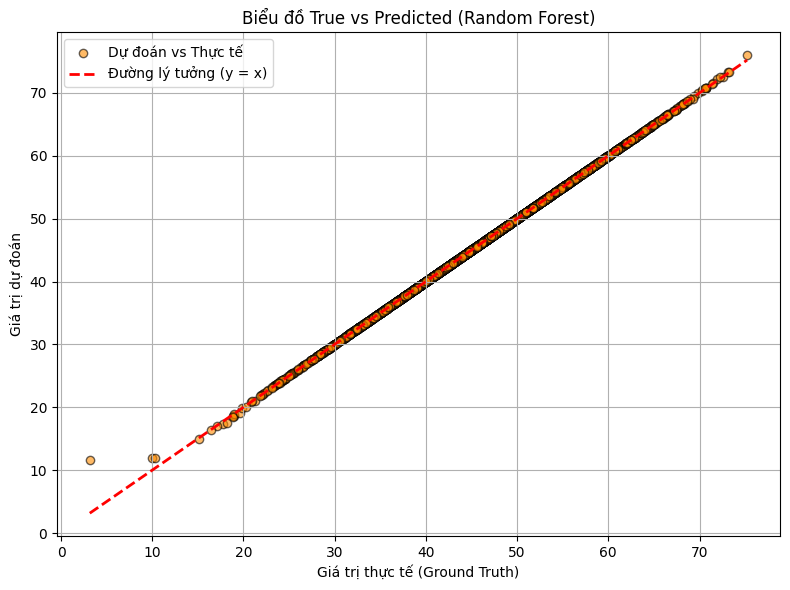

In [33]:
import matplotlib.pyplot as plt

# Chuyển đổi nếu cần
rf_pred = np.array(rf_pred)
y_test = np.array(y_test)

# Vẽ biểu đồ True vs Predicted
plt.figure(figsize=(8, 6))
plt.scatter(y_test, rf_pred, alpha=0.6, color='darkorange', edgecolors='k', label='Dự đoán vs Thực tế')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()],
         'r--', lw=2, label='Đường lý tưởng (y = x)')
plt.xlabel("Giá trị thực tế (Ground Truth)")
plt.ylabel("Giá trị dự đoán")
plt.title("Biểu đồ True vs Predicted (Random Forest)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [34]:
import joblib
# Lưu mô hình Random Forest vào tệp pickle
model_path = r"D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\rf_model.pkl"
joblib.dump(rf_model, model_path)
print(f"Mô hình Random Forest đã được lưu tại: {model_path}")

Mô hình Random Forest đã được lưu tại: D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\rf_model.pkl


##### MÔ HÌNH HISTGRADIENTBOOSTING

In [35]:
# 2. Build Model HistGradientBoosting
hgb_model = HistGradientBoostingRegressor(max_iter=100, random_state=42)
hgb_model.fit(X_train, y_train, sample_weight=sample_weights)
hgb_pred = hgb_model.predict(X_test)
model_results['HistGradientBoosting'] = {
    'predictions': hgb_pred,
    'mse': mean_squared_error(y_test, hgb_pred),
    'r2': r2_score(y_test, hgb_pred)
}
print(f"HGBoosting MSE: {mean_squared_error(y_test, hgb_pred):.4f}")
print(f"HGBoosting R2: {r2_score(y_test, hgb_pred):.4f}")

HGBoosting MSE: 0.1135
HGBoosting R2: 0.9987


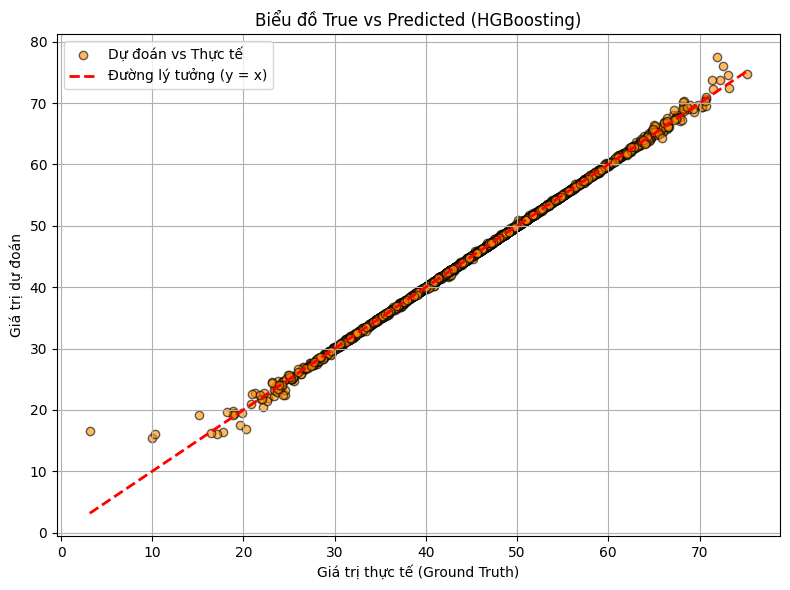

In [36]:
import matplotlib.pyplot as plt

# Chuyển đổi nếu cần
hgb_pred = np.array(hgb_pred)
y_test = np.array(y_test)

# Vẽ biểu đồ True vs Predicted
plt.figure(figsize=(8, 6))
plt.scatter(y_test, hgb_pred, alpha=0.6, color='darkorange', edgecolors='k', label='Dự đoán vs Thực tế')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()],
         'r--', lw=2, label='Đường lý tưởng (y = x)')
plt.xlabel("Giá trị thực tế (Ground Truth)")
plt.ylabel("Giá trị dự đoán")
plt.title("Biểu đồ True vs Predicted (HGBoosting)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [37]:
# Lưu mô hình HistGradientBoosting vào tệp pickle
model_path = r"D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\hgb_model.pkl"
joblib.dump(hgb_model, model_path)
print(f"Mô hình HistGradientBoosting đã được lưu tại: {model_path}")

Mô hình HistGradientBoosting đã được lưu tại: D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\hgb_model.pkl


##### MÔ HÌNH XGBOOST

In [99]:
# 3. Build Model XGBoost
xgb_model = xgb.XGBRegressor(n_estimators=100, random_state=42, objective='reg:squarederror')
xgb_model.fit(X_train, y_train, sample_weight=sample_weights)
xgb_pred = xgb_model.predict(X_test)
model_results['XGBoost'] = {
    'predictions': xgb_pred,
    'mse': mean_squared_error(y_test, xgb_pred),
    'r2': r2_score(y_test, xgb_pred)
}
print(f"XGBoost MSE: {mean_squared_error(y_test, xgb_pred):.4f}")
print(f"XGBoost R2: {r2_score(y_test, xgb_pred):.4f}")

XGBoost MSE: 0.0312
XGBoost R2: 0.9996


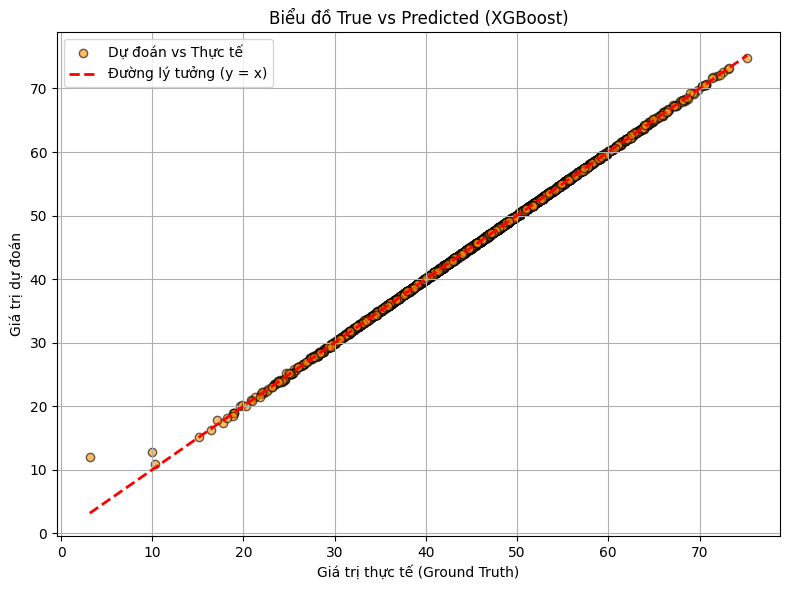

In [100]:
import matplotlib.pyplot as plt

# Chuyển đổi nếu cần
xgb_pred = np.array(xgb_pred)
y_test = np.array(y_test)

# Vẽ biểu đồ True vs Predicted
plt.figure(figsize=(8, 6))
plt.scatter(y_test, xgb_pred, alpha=0.6, color='darkorange', edgecolors='k', label='Dự đoán vs Thực tế')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()],
         'r--', lw=2, label='Đường lý tưởng (y = x)')
plt.xlabel("Giá trị thực tế (Ground Truth)")
plt.ylabel("Giá trị dự đoán")
plt.title("Biểu đồ True vs Predicted (XGBoost)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [101]:
# Lưu mô hình XGBoost vào tệp pickle
model_path = r"D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\xgb_model.pkl"
joblib.dump(xgb_model, model_path)
print(f"Mô hình XGBoost đã được lưu tại: {model_path}")

Mô hình XGBoost đã được lưu tại: D:\BaiDoAnChuyenNganh3\NLPResumeRankingAutomatedSystem\model\xgb_model.pkl


#### XÂY DỰNG MÔ HÌNH DEEP LEARNING

##### MÔ HÌNH MLP (MULTI-LAYER PERCEPTRON)

In [41]:
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

In [42]:
# Định nghĩa dataset cho PyTorch
class CVDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [43]:
# Định nghĩa mô hình MLP
class MLP(nn.Module):
    def __init__(self, input_dim):
        super(MLP, self).__init__()
        self.layer1 = nn.Linear(input_dim, 512)
        self.layer2 = nn.Linear(512, 256)
        self.layer3 = nn.Linear(256, 128)
        self.layer4 = nn.Linear(128, 1)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.2)
    
    def forward(self, x):
        x = self.relu(self.layer1(x))
        x = self.dropout(x)
        x = self.relu(self.layer2(x))
        x = self.dropout(x)
        x = self.relu(self.layer3(x))
        x = self.layer4(x)
        return x


In [44]:
# Chia tập train thành train và validation để dùng cho early stopping
X_train_sub, X_val, y_train_sub, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

In [45]:
# Chuyển dữ liệu thành PyTorch Dataset
train_sub_dataset = CVDataset(X_train_sub, y_train_sub)
val_dataset = CVDataset(X_val, y_val)
test_dataset = CVDataset(X_test, y_test)

In [46]:
# Tạo DataLoader
batch_size = 64
train_sub_loader = DataLoader(train_sub_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
# Khởi tạo mô hình, loss function và optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input_dim = X_train.shape[1]
mlp_model = MLP(input_dim).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(mlp_model.parameters(), lr=0.0001, weight_decay=1e-5) 

In [48]:
# Huấn luyện mô hình với early stopping
num_epochs = 150
patience = 15
best_loss = float('inf')
patience_counter = 0
best_model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/mlp_model_best.pth"

logging.info("Bắt đầu huấn luyện mô hình MLP với early stopping...")
for epoch in range(num_epochs):
    mlp_model.train()
    total_loss = 0
    batch_count = 0
    start_time = time.time()
    
    for batch_X, batch_y in train_sub_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        optimizer.zero_grad()
        outputs = mlp_model(batch_X).squeeze()
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        batch_count += 1
        print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_count}/{len(train_sub_loader)}], Batch Loss: {loss.item():.4f}")
    
    epoch_time = time.time() - start_time
    avg_train_loss = total_loss / len(train_sub_loader)
    
    # Đánh giá trên tập validation
    mlp_model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch_X, batch_y in val_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            outputs = mlp_model(batch_X).squeeze()
            loss = criterion(outputs, batch_y)
            val_loss += loss.item()
    avg_val_loss = val_loss / len(val_loader)
    
    logging.info(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    
    # Early stopping
    if avg_val_loss < best_loss:
        best_loss = avg_val_loss
        patience_counter = 0
        torch.save(mlp_model.state_dict(), best_model_path)
        print(f"Đã lưu mô hình tốt nhất tại epoch {epoch+1} với Val Loss: {best_loss:.4f}")
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print(f"Dừng sớm được kích hoạt tại epoch {epoch+1}")
            break


Epoch [1/150], Batch [1/220], Batch Loss: 1942.4272
Epoch [1/150], Batch [2/220], Batch Loss: 2068.5828
Epoch [1/150], Batch [3/220], Batch Loss: 2031.8408
Epoch [1/150], Batch [4/220], Batch Loss: 2096.9155
Epoch [1/150], Batch [5/220], Batch Loss: 2166.9302
Epoch [1/150], Batch [6/220], Batch Loss: 2042.9238
Epoch [1/150], Batch [7/220], Batch Loss: 2356.3486
Epoch [1/150], Batch [8/220], Batch Loss: 2170.1919
Epoch [1/150], Batch [9/220], Batch Loss: 2099.4883
Epoch [1/150], Batch [10/220], Batch Loss: 2265.5840
Epoch [1/150], Batch [11/220], Batch Loss: 2159.7080
Epoch [1/150], Batch [12/220], Batch Loss: 2133.8567
Epoch [1/150], Batch [13/220], Batch Loss: 2162.3120
Epoch [1/150], Batch [14/220], Batch Loss: 2342.2617
Epoch [1/150], Batch [15/220], Batch Loss: 2221.9753
Epoch [1/150], Batch [16/220], Batch Loss: 2117.1790
Epoch [1/150], Batch [17/220], Batch Loss: 2212.4453
Epoch [1/150], Batch [18/220], Batch Loss: 2258.0818
Epoch [1/150], Batch [19/220], Batch Loss: 2129.6257
Ep

In [49]:
# Load mô hình tốt nhất để đánh giá
mlp_model.load_state_dict(torch.load(best_model_path))
mlp_model.eval()
mlp_pred = []
y_true = []
with torch.no_grad():
    for batch_X, batch_y in test_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        outputs = mlp_model(batch_X).squeeze()
        mlp_pred.extend(outputs.cpu().numpy())
        y_true.extend(batch_y.cpu().numpy())

C:\Users\tgdd\AppData\Local\Temp\ipykernel_18748\2791527396.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mlp_model.load_state_dict(torch.load(best_model_path))


In [50]:
# Tính toán metrics
mlp_mse = mean_squared_error(y_true, mlp_pred)
mlp_r2 = r2_score(y_true, mlp_pred)
print(f"MLP MSE: {mlp_mse:.4f}")
print(f"MLP R2: {mlp_r2:.4f}")
logging.info(f"MLP MSE: {mlp_mse:.4f}, R2: {mlp_r2:.4f}")

MLP MSE: 0.1656
MLP R2: 0.9980


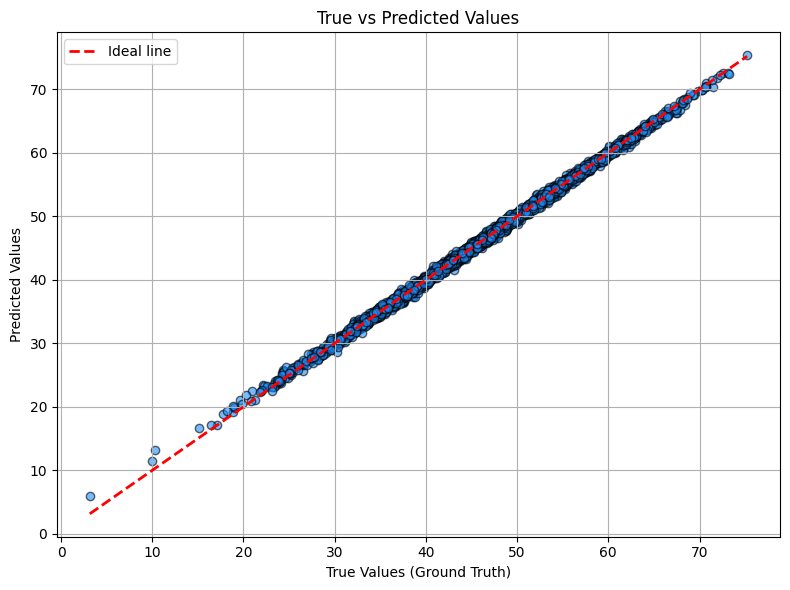

In [51]:
import matplotlib.pyplot as plt

# Chuyển list về numpy array nếu cần
y_true = np.array(y_true)
mlp_pred = np.array(mlp_pred)

# Vẽ scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_true, mlp_pred, alpha=0.6, color='dodgerblue', edgecolors='k', label="")
plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--', lw=2, label="Ideal line")

plt.title("True vs Predicted Values")
plt.xlabel("True Values (Ground Truth)")
plt.ylabel("Predicted Values")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [52]:
model_results['MLP'] = {
    'predictions': mlp_pred,
    'mse': mean_squared_error(y_true, mlp_pred),
    'r2': r2_score(y_true, mlp_pred)
}

In [53]:
# Lưu mô hình
model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/mlp_model.pth"
torch.save(mlp_model.state_dict(), model_path)
print(f"Mô hình MLP đã được lưu tại: {model_path}")
logging.info(f"Mô hình MLP đã được lưu tại: {model_path}")

Mô hình MLP đã được lưu tại: D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/mlp_model.pth


##### MÔ HÌNH LSTM (LONG SHORT-TERM MEMORY)

In [54]:
# Định nghĩa dataset cho PyTorch
class CVDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [ ]:
# Định nghĩa mô hình LSTM
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_layers):
        super(LSTMModel, self).__init__()
        self.hidden_dim = hidden_dim # thuộc tính của lớp 
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True, dropout=0.2)  # Giảm dropout
        self.fc = nn.Linear(hidden_dim, 1)
    
    def forward(self, x):
        # Reshape input to (batch_size, seq_len, input_dim)
        x = x.unsqueeze(1)  # (biến đổi input_dim thành (batch_size, 1, input_dim))
        # Khởi tạo trạng thái ẩn (h0) và trạng thái ô nhớ (c0) ban đầu là 0
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_dim).to(x.device)
        out, _ = self.lstm(x, (h0, c0)) # Cho input và trạng thái ban đầu vào LSTM
        out = self.fc(out[:, -1, :]) # Lấy đầu ra của bước thời gian cuối cùng từ LSTM và đưa qua lớp FC
        return out # Trả về kết quả

In [56]:
# Chia tập train thành train và validation để dùng cho early stopping
X_train_sub, X_val, y_train_sub, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

In [57]:
# Chuyển dữ liệu thành PyTorch Dataset
train_sub_dataset = CVDataset(X_train_sub, y_train_sub)
val_dataset = CVDataset(X_val, y_val)
test_dataset = CVDataset(X_test, y_test)

In [58]:
# Tạo DataLoader
batch_size = 32
train_sub_loader = DataLoader(train_sub_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [59]:
# Khởi tạo mô hình, loss function và optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input_dim = X_train.shape[1]
hidden_dim = 128
num_layers = 2
lstm_model = LSTMModel(input_dim, hidden_dim, num_layers).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(lstm_model.parameters(), lr=0.0001, weight_decay=1e-5) 

In [60]:
# Huấn luyện mô hình với early stopping
num_epochs = 200
patience = 15 
best_loss = float('inf')
patience_counter = 0
best_model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/lstm_model_best.pth"

logging.info("Bắt đầu huấn luyện mô hình LSTM với early stopping...")
for epoch in range(num_epochs):
    lstm_model.train()
    total_loss = 0
    batch_count = 0
    start_time = time.time()
    
    for batch_X, batch_y in train_sub_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        optimizer.zero_grad()
        outputs = lstm_model(batch_X).squeeze()
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        batch_count += 1
        print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_count}/{len(train_sub_loader)}], Batch Loss: {loss.item():.4f}")
    
    epoch_time = time.time() - start_time
    avg_train_loss = total_loss / len(train_sub_loader)
    
    # Đánh giá trên tập validation
    lstm_model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch_X, batch_y in val_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            outputs = lstm_model(batch_X).squeeze()
            loss = criterion(outputs, batch_y)
            val_loss += loss.item()
    avg_val_loss = val_loss / len(val_loader)
    
    logging.info(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    
    # Early stopping
    if avg_val_loss < best_loss:
        best_loss = avg_val_loss
        patience_counter = 0
        torch.save(lstm_model.state_dict(), best_model_path)
        print(f"Đã lưu mô hình tốt nhất tại epoch {epoch+1} với Val Loss: {best_loss:.4f}")
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print(f"Dừng sớm được kích hoạt tại epoch {epoch+1}")
            break

Epoch [1/200], Batch [1/440], Batch Loss: 2288.4170
Epoch [1/200], Batch [2/440], Batch Loss: 2326.1179
Epoch [1/200], Batch [3/440], Batch Loss: 2191.8625
Epoch [1/200], Batch [4/440], Batch Loss: 2190.9380
Epoch [1/200], Batch [5/440], Batch Loss: 2075.6677
Epoch [1/200], Batch [6/440], Batch Loss: 2182.7478
Epoch [1/200], Batch [7/440], Batch Loss: 2077.6738
Epoch [1/200], Batch [8/440], Batch Loss: 2194.9150
Epoch [1/200], Batch [9/440], Batch Loss: 2378.5513
Epoch [1/200], Batch [10/440], Batch Loss: 2003.6921
Epoch [1/200], Batch [11/440], Batch Loss: 2290.2202
Epoch [1/200], Batch [12/440], Batch Loss: 2083.1992
Epoch [1/200], Batch [13/440], Batch Loss: 2022.6108
Epoch [1/200], Batch [14/440], Batch Loss: 2131.0278
Epoch [1/200], Batch [15/440], Batch Loss: 2534.8176
Epoch [1/200], Batch [16/440], Batch Loss: 2501.2903
Epoch [1/200], Batch [17/440], Batch Loss: 2272.7627
Epoch [1/200], Batch [18/440], Batch Loss: 2264.6116
Epoch [1/200], Batch [19/440], Batch Loss: 1994.1213
Ep

In [61]:
# Đánh giá mô hình
lstm_model.eval()
lstm_pred = []
y_true = []
with torch.no_grad():
    for batch_X, batch_y in test_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        outputs = lstm_model(batch_X).squeeze()
        lstm_pred.extend(outputs.cpu().numpy())
        y_true.extend(batch_y.cpu().numpy())

In [62]:
# Tính toán metrics
lstm_mse = mean_squared_error(y_true, lstm_pred)
lstm_r2 = r2_score(y_true, lstm_pred)
print(f"Optimized LSTM MSE: {lstm_mse:.4f}")
print(f"Optimized LSTM R2: {lstm_r2:.4f}")
logging.info(f"Optimized LSTM MSE: {lstm_mse:.4f}, R2: {lstm_r2:.4f}")

Optimized LSTM MSE: 0.1156
Optimized LSTM R2: 0.9986


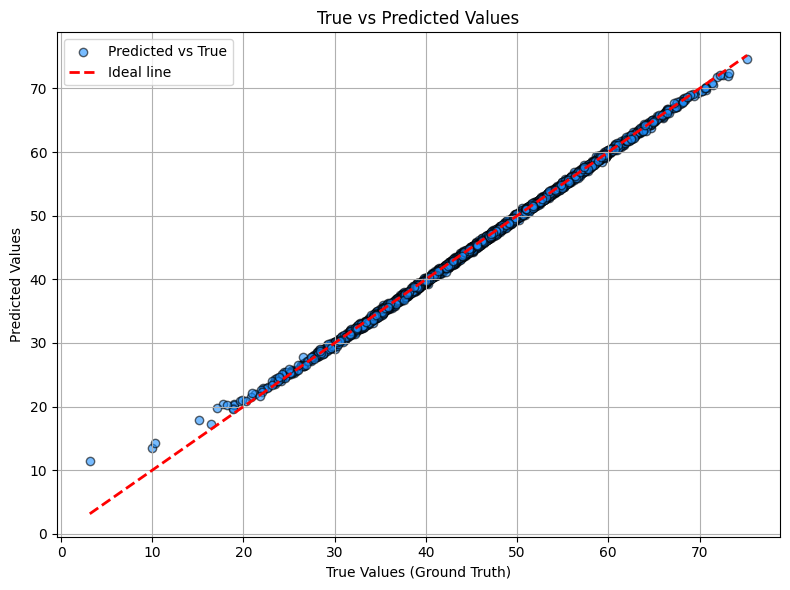

In [63]:
import matplotlib.pyplot as plt

# Chuyển list về numpy array nếu cần
y_true = np.array(y_true)
lstm_pred = np.array(lstm_pred)

# Vẽ scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_true, lstm_pred, alpha=0.6, color='dodgerblue', edgecolors='k', label="Predicted vs True")
plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--', lw=2, label="Ideal line")

plt.title("True vs Predicted Values")
plt.xlabel("True Values (Ground Truth)")
plt.ylabel("Predicted Values")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [64]:
model_results['LSTM'] = {
    'predictions': lstm_pred,
    'mse': mean_squared_error(y_true, lstm_pred),
    'r2': r2_score(y_true, lstm_pred)
}

In [65]:
# Lưu mô hình
model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/lstm_model.pth"
torch.save(lstm_model.state_dict(), model_path)
print(f"Mô hình LSTM đã được lưu tại: {model_path}")
logging.info(f"Mô hình LSTM đã được lưu tại: {model_path}")

Mô hình LSTM đã được lưu tại: D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/lstm_model.pth


##### MÔ HÌNH TRANSFORMER

In [66]:
# Định nghĩa dataset cho PyTorch
class CVDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [ ]:
# Định nghĩa mô hình Transformer
class TransformerModel(nn.Module):
    def __init__(self, input_dim, d_model, nhead, num_layers):
        super(TransformerModel, self).__init__()
        self.input_projection = nn.Linear(input_dim, d_model) # biến đổi input sang d
        self.transformer = nn.TransformerEncoder(
            nn.TransformerEncoderLayer(d_model=d_model, nhead=nhead, dropout=0.2),
            num_layers=num_layers
        )
        self.fc = nn.Linear(d_model, 1)
    
    def forward(self, x):
        x = x.unsqueeze(1)  # (biến đổi input_dim thành (batch_size, 1, input_dim))
        x = self.input_projection(x) # Chiếu input
        x = self.transformer(x) # Input qua Transformer Encoder
        x = x[:, -1, :]  # Lấy output cuối cùng Transformer
        x = self.fc(x) # Qua lớp đầu ra
        return x       # Trả về kết quả

In [68]:
# Chia tập train thành train và validation để dùng cho early stopping
X_train_sub, X_val, y_train_sub, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

In [69]:
# Chuyển dữ liệu thành PyTorch Dataset
train_sub_dataset = CVDataset(X_train_sub, y_train_sub)
val_dataset = CVDataset(X_val, y_val)
test_dataset = CVDataset(X_test, y_test)

In [70]:
# Tạo DataLoader
batch_size = 4
train_sub_loader = DataLoader(train_sub_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [71]:
# Khởi tạo mô hình, loss function và optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input_dim = X_train.shape[1]
d_model = 128  # Đảm bảo d_model chia hết cho nhead
nhead = 4
num_layers = 2
transformer_model = TransformerModel(input_dim, d_model, nhead, num_layers).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(transformer_model.parameters(), lr=0.0001, weight_decay=1e-5) 

d:\BaiDoAnChuyenNganh3\.venv\Lib\site-packages\torch\nn\modules\transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(


In [72]:
# Huấn luyện mô hình với early stopping
num_epochs = 100
patience = 15
best_loss = float('inf')
patience_counter = 0
best_model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/transformer_model_best.pth"

logging.info("Bắt đầu huấn luyện mô hình Transformer với early stopping...")
for epoch in range(num_epochs):
    transformer_model.train()
    total_loss = 0
    batch_count = 0
    start_time = time.time()
    
    for batch_X, batch_y in train_sub_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        optimizer.zero_grad()
        outputs = transformer_model(batch_X).squeeze()
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        batch_count += 1
        print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_count}/{len(train_sub_loader)}], Batch Loss: {loss.item():.4f}")
    
    epoch_time = time.time() - start_time
    avg_train_loss = total_loss / len(train_sub_loader)
    
    # Đánh giá trên tập validation
    transformer_model.eval()
    val_loss = 0
    with torch.no_grad():
        for batch_X, batch_y in val_loader:
            batch_X, batch_y = batch_X.to(device), batch_y.to(device)
            outputs = transformer_model(batch_X).squeeze()
            loss = criterion(outputs, batch_y)
            val_loss += loss.item()
    avg_val_loss = val_loss / len(val_loader)
    
    logging.info(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, Time: {epoch_time:.2f}s, Batches: {batch_count}")
    
    # Early stopping
    if avg_val_loss < best_loss:
        best_loss = avg_val_loss
        patience_counter = 0
        torch.save(transformer_model.state_dict(), best_model_path)
        print(f"Đã lưu mô hình tốt nhất tại epoch {epoch+1} với Val Loss: {best_loss:.4f}")
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print(f"Dừng sớm được kích hoạt tại epoch {epoch+1}")
            break


Epoch [1/100], Batch [1/3519], Batch Loss: 2350.5117
Epoch [1/100], Batch [2/3519], Batch Loss: 1565.5518
Epoch [1/100], Batch [3/3519], Batch Loss: 2325.8223
Epoch [1/100], Batch [4/3519], Batch Loss: 1937.0912
Epoch [1/100], Batch [5/3519], Batch Loss: 1648.0933
Epoch [1/100], Batch [6/3519], Batch Loss: 2506.6829
Epoch [1/100], Batch [7/3519], Batch Loss: 1193.1656
Epoch [1/100], Batch [8/3519], Batch Loss: 1530.5542
Epoch [1/100], Batch [9/3519], Batch Loss: 2051.5315
Epoch [1/100], Batch [10/3519], Batch Loss: 1444.2336
Epoch [1/100], Batch [11/3519], Batch Loss: 1464.0016
Epoch [1/100], Batch [12/3519], Batch Loss: 1424.0461
Epoch [1/100], Batch [13/3519], Batch Loss: 1202.2710
Epoch [1/100], Batch [14/3519], Batch Loss: 1924.0935
Epoch [1/100], Batch [15/3519], Batch Loss: 1705.1998
Epoch [1/100], Batch [16/3519], Batch Loss: 1744.8584
Epoch [1/100], Batch [17/3519], Batch Loss: 2501.0630
Epoch [1/100], Batch [18/3519], Batch Loss: 1594.0255
Epoch [1/100], Batch [19/3519], Batch

In [ ]:
# Epoch 99 Val Loss = 0.0729
# Load mô hình tốt nhất để đánh giá
transformer_model.load_state_dict(torch.load(best_model_path))
transformer_model.eval()
transformer_pred = []
y_true = []
with torch.no_grad():
    for batch_X, batch_y in test_loader:
        batch_X, batch_y = batch_X.to(device), batch_y.to(device)
        outputs = transformer_model(batch_X).squeeze()
        transformer_pred.extend(outputs.cpu().numpy())
        y_true.extend(batch_y.cpu().numpy())

C:\Users\tgdd\AppData\Local\Temp\ipykernel_18748\3434108200.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  transformer_model.load_state_dict(torch.load(best_model_path)

In [74]:
# Tính toán metrics
mse = mean_squared_error(y_true, transformer_pred)
r2 = r2_score(y_true, transformer_pred)
print(f"Transformer MSE: {mse:.4f}")
print(f"Transformer R2: {r2:.4f}")
logging.info(f"Transformer MSE: {mse:.4f}, R2: {r2:.4f}")

Transformer MSE: 0.0730
Transformer R2: 0.9991


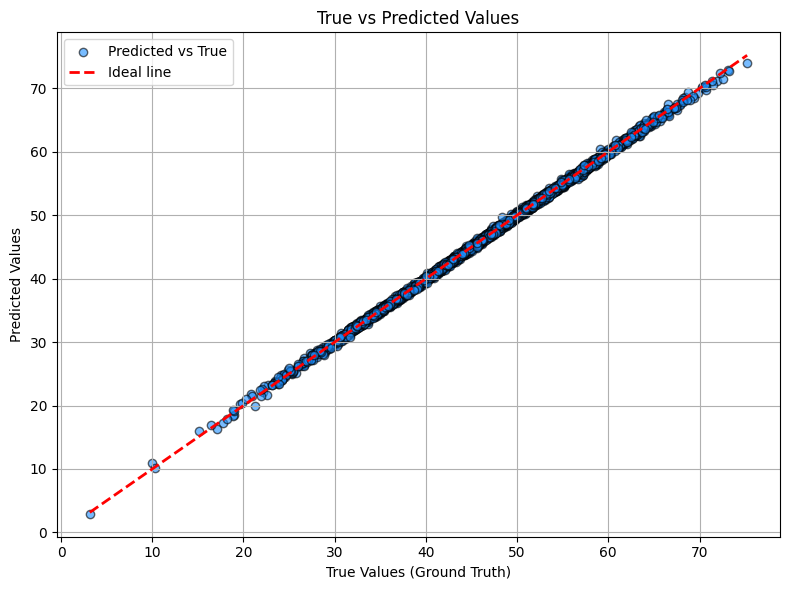

In [75]:
import matplotlib.pyplot as plt

# Chuyển list về numpy array nếu cần
y_true = np.array(y_true)
transformer_pred = np.array(transformer_pred)

# Vẽ scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y_true, transformer_pred, alpha=0.6, color='dodgerblue', edgecolors='k', label="Predicted vs True")
plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--', lw=2, label="Ideal line")

plt.title("True vs Predicted Values")
plt.xlabel("True Values (Ground Truth)")
plt.ylabel("Predicted Values")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [76]:
model_results['TRANSFORMER'] = {
    'predictions': transformer_pred,
    'mse': mean_squared_error(y_true, transformer_pred),
    'r2': r2_score(y_true, transformer_pred)
}

In [77]:
# Lưu mô hình
model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/transformer_model.pth"
torch.save(transformer_model.state_dict(), model_path)
print(f"Mô hình TRANSFORMER đã được lưu tại: {model_path}")
logging.info(f"Mô hình TRANSFORMER đã được lưu tại: {model_path}")

Mô hình TRANSFORMER đã được lưu tại: D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/transformer_model.pth


##### KẾT HỢP 3 MÔ HÌNH TỐT NHẤT RANDOM FOREST + XGBOOST + TRANSFORMER

In [ ]:
# Định nghĩa lớp Ensemble
class EnsembleRXTModel(nn.Module):
    def __init__(self, rf_model, xgb_model, transformer_model, rf_weight=0.6, xgb_weight=0.2, transformer_weight=0.2):
        super(EnsembleRXTModel, self).__init__()
        self.rf_model = rf_model  
        self.xgb_model = xgb_model  
        self.transformer_model = transformer_model  
        self.rf_weight = rf_weight
        self.xgb_weight = xgb_weight
        self.transformer_weight = transformer_weight
    
    def forward(self, x):
        # Chuyển tensor PyTorch thành mảng NumPy cho Random Forest và XGBoost
        x_numpy = x.cpu().numpy()

        # Dự đoán từ Random Forest và XGBoost
        rf_output = self.rf_model.predict(x_numpy)  # Đầu ra là mảng NumPy
        xgb_output = self.xgb_model.predict(x_numpy)  # Đầu ra là mảng NumPy

        # Chuyển đổi đầu ra của Random Forest và XGBoost thành tensor PyTorch
        rf_output = torch.tensor(rf_output, dtype=torch.float32).to(x.device)
        xgb_output = torch.tensor(xgb_output, dtype=torch.float32).to(x.device)

        # Dự đoán từ Transformer (đã là tensor PyTorch)
        transformer_output = self.transformer_model(x).squeeze()

        # Kết hợp dự đoán theo trọng số
        ensemble_output = (self.rf_weight * rf_output +
                           self.xgb_weight * xgb_output +
                           self.transformer_weight * transformer_output)
        return ensemble_output

In [79]:
# Tạo mô hình ensemble rf + xgb + transformer
rf_xgb_transformer_model = EnsembleRXTModel(rf_model, xgb_model, transformer_model, rf_weight=0.6, xgb_weight=0.2, transformer_weight=0.2).to(device)

In [80]:
# Dự đoán với mô hình rf + xgb + transformer
with torch.no_grad():
    X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
    rf_xgb_transformer_pred = rf_xgb_transformer_model(X_test_tensor).cpu().numpy()
    
# Tính metrics
rf_xgb_transformer_mse = mean_squared_error(y_true, rf_xgb_transformer_pred)
rf_xgb_transformer_r2 = r2_score(y_true, rf_xgb_transformer_pred)
print(f"Ensemble RANDOM FOREST + XGBOOST + TRANSFORMER MSE: {rf_xgb_transformer_mse:.4f}")
print(f"Ensemble RANDOM FOREST + XGBOOST + TRANSFORMER R² : {rf_xgb_transformer_r2:.4f}")

Ensemble RANDOM FOREST + XGBOOST + TRANSFORMER MSE: 0.0165
Ensemble RANDOM FOREST + XGBOOST + TRANSFORMER R² : 0.9998


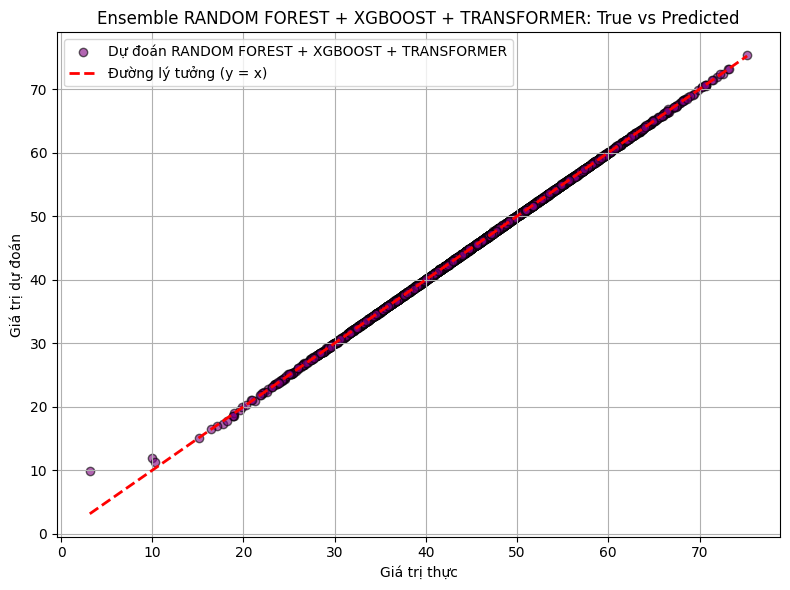

In [81]:
plt.figure(figsize=(8, 6))
plt.scatter(y_true, rf_xgb_transformer_pred, alpha=0.6, color='purple', edgecolors='k', label='Dự đoán RANDOM FOREST + XGBOOST + TRANSFORMER')
plt.plot([y_true.min(), y_true.max()],
         [y_true.min(), y_true.max()],
         'r--', lw=2, label='Đường lý tưởng (y = x)')
plt.xlabel("Giá trị thực")
plt.ylabel("Giá trị dự đoán")
plt.title("Ensemble RANDOM FOREST + XGBOOST + TRANSFORMER: True vs Predicted")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [82]:
model_results['RANDOM FOREST + XGBOOST + TRANSFORMER'] = {
    'predictions': rf_xgb_transformer_pred,
    'mse': mean_squared_error(y_true, rf_xgb_transformer_pred),
    'r2': r2_score(y_true, rf_xgb_transformer_pred)
}

In [83]:
# Lưu mô hình
model_path = "D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/rf_xgb_transformer_model.pth"
torch.save(rf_xgb_transformer_model.state_dict(), model_path)
print(f"Mô hình RANDOM FOREST + XGBOOST + TRANSFORMER đã được lưu tại: {model_path}")
logging.info(f"Mô hình RANDOM FOREST + XGBOOST + TRANSFORMER đã được lưu tại: {model_path}")

Mô hình RANDOM FOREST + XGBOOST + TRANSFORMER đã được lưu tại: D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/rf_xgb_transformer_model.pth


### SO SÁNH CÁC MÔ HÌNH VÀ CHỌN RA MÔ HÌNH TỐT NHẤT

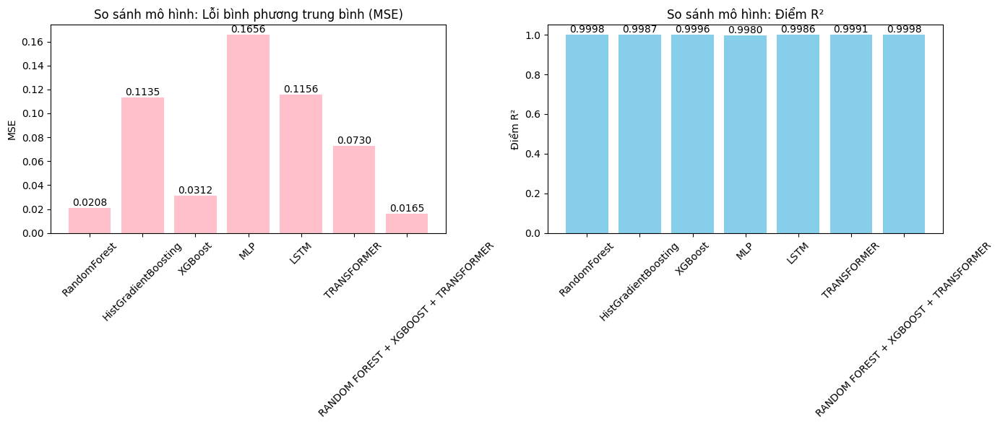

In [103]:
import matplotlib.pyplot as plt

# Visualize performance comparison (MSE and R²)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))
models = list(model_results.keys())
mses = [result['mse'] for result in model_results.values()]
r2s = [result['r2'] for result in model_results.values()]

# Bar plot for MSE
bars1 = ax1.bar(models, mses, color='pink')
ax1.set_title('So sánh mô hình: Lỗi bình phương trung bình (MSE)')
ax1.set_ylabel('MSE')
ax1.tick_params(axis='x', rotation=45)
# Thêm chỉ số MSE lên đầu cột
for bar in bars1:
    height = bar.get_height()
    ax1.text(bar.get_x() + bar.get_width() / 2., height,
             f'{height:.4f}',
             ha='center', va='bottom')

# Bar plot for R²
bars2 = ax2.bar(models, r2s, color='skyblue')
ax2.set_title('So sánh mô hình: Điểm R²')
ax2.set_ylabel('Điểm R²')
ax2.tick_params(axis='x', rotation=45)
# Thêm chỉ số R² lên đầu cột
for bar in bars2:
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width() / 2., height,
             f'{height:.4f}',
             ha='center', va='bottom')

plt.tight_layout()
plt.show()  

In [104]:
# Select the best model based on MSE
best_model_name = min(model_results, key=lambda k: model_results[k]['mse'])
print(f"\nMô hình tốt nhất (dựa trên MSE thấp nhất): {best_model_name}")
print(f"MSE: {model_results[best_model_name]['mse']:.4f}")
print(f"R²: {model_results[best_model_name]['r2']:.4f}")


Mô hình tốt nhất (dựa trên MSE thấp nhất): RANDOM FOREST + XGBOOST + TRANSFORMER
MSE: 0.0165
R²: 0.9998


### TEST DỰ ĐOÁN ĐIỂM SỐ TRÊN MÔ HÌNH MACHINE LEARNING

In [86]:
# Test prediction
sample_cv = cv_texts[2]
sample_jd = jd_texts[2]

In [87]:
# Generate embeddings for the sample
cv_embedding = model_st.encode([sample_cv])
jd_embedding = model_st.encode([sample_jd])

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

In [88]:
# Calculate cosine similarity
similarity = cosine_similarity(cv_embedding, jd_embedding)[0][0]

In [89]:
# Extract NER features for the sample
cv_feat = cv_features[2]  # Already extracted during preprocessing
jd_feat = jd_features[2]  # Already extracted during preprocessing
ner_feats = combine_ner_features(cv_feat, jd_feat)

In [90]:
# Reshape ner_feats and similarity to match the 2D shape
ner_feats = np.array(ner_feats).reshape(1, -1)  # Shape: (1, 3)
similarity_array = np.array([similarity]).reshape(1, -1)  # Shape: (1, 1)

In [91]:
# Combine features
features = np.hstack([cv_embedding, jd_embedding, ner_feats, similarity_array])  # Shape: (1, 384 + 384 + 3 + 1)

In [92]:
import joblib
rf_model = joblib.load("D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/rf_model.pkl")

In [93]:
# Predict score
score = rf_model.predict(features)[0]
print(f"Điểm dự đoán cho cặp CV-JD mẫu: {score:.2f}")

Điểm dự đoán cho cặp CV-JD mẫu: 49.79


### TEST DỰ ĐOÁN ĐIỂM SỐ TRÊN MÔ HÌNH ENSEMBLE RANDOM + XGBOOST + TRANSFORMER

In [94]:
import joblib
import torch
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

In [95]:
# Thiết lập device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Tải lại các mô hình từ file
# 1. Tải Random Forest
rf_model = joblib.load("D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/rf_model.pkl")

# 2. Tải XGBoost
xgb_model = joblib.load("D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/xgb_model.pkl")

# 3. Tải Transformer
transformer_model = TransformerModel(input_dim, d_model, nhead, num_layers).to(device)
transformer_model.load_state_dict(torch.load("D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/transformer_model_best.pth"))
transformer_model.eval()

# Định nghĩa lớp Ensemble
class EnsembleRXTModel(torch.nn.Module):
    def __init__(self, rf_model, xgb_model, transformer_model, rf_weight=0.6, xgb_weight=0.2, transformer_weight=0.2):
        super(EnsembleRXTModel, self).__init__()
        self.rf_model = rf_model
        self.xgb_model = xgb_model
        self.transformer_model = transformer_model
        self.rf_weight = rf_weight
        self.xgb_weight = xgb_weight
        self.transformer_weight = transformer_weight
    
    def forward(self, x):
        # Chuyển tensor PyTorch thành mảng NumPy
        x_numpy = x.cpu().numpy()

        # Dự đoán từ Random Forest và XGBoost
        rf_output = torch.tensor(self.rf_model.predict(x_numpy), dtype=torch.float32).to(x.device)
        xgb_output = torch.tensor(self.xgb_model.predict(x_numpy), dtype=torch.float32).to(x.device)

        # Dự đoán từ Transformer
        transformer_output = self.transformer_model(x).squeeze()

        # Kết hợp dự đoán
        ensemble_output = (self.rf_weight * rf_output +
                           self.xgb_weight * xgb_output +
                           self.transformer_weight * transformer_output)
        return ensemble_output

# Tạo mô hình ensemble
rf_xgb_transformer_model = EnsembleRXTModel(rf_model, xgb_model, transformer_model, rf_weight=0.6, xgb_weight=0.2, transformer_weight=0.2).to(device)

d:\BaiDoAnChuyenNganh3\.venv\Lib\site-packages\torch\nn\modules\transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(
C:\Users\tgdd\AppData\Local\Temp\ipykernel_18748\479624218.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.a

In [96]:
# Test prediction
sample_cv = cv_texts[2]
sample_jd = jd_texts[2]

# Generate embeddings for the sample
cv_embedding = model_st.encode([sample_cv])
jd_embedding = model_st.encode([sample_jd])

# Calculate cosine similarity
similarity = cosine_similarity(cv_embedding, jd_embedding)[0][0]

# Extract NER features for the sample
cv_feat = cv_features[2]  # Already extracted during preprocessing
jd_feat = jd_features[2]  # Already extracted during preprocessing
ner_feats = combine_ner_features(cv_feat, jd_feat)

# Reshape ner_feats and similarity to match the 2D shape
ner_feats = np.array(ner_feats).reshape(1, -1)  # Shape: (1, 3)
similarity_array = np.array([similarity]).reshape(1, -1)  # Shape: (1, 1)

# Combine features
features = np.hstack([cv_embedding, jd_embedding, ner_feats, similarity_array])  # Shape: (1, 384 + 384 + 3 + 1)

# Chuyển features thành tensor PyTorch
features_tensor = torch.tensor(features, dtype=torch.float32).to(device)

# Dự đoán điểm số
with torch.no_grad():
    ensemble_score = rf_xgb_transformer_model(features_tensor).cpu().numpy()[0]

# Đảm bảo điểm nằm trong thang 0-100
ensemble_score = np.clip(ensemble_score, 0, 100)

# In kết quả
print(f"Điểm dự đoán cho cặp CV-JD mẫu (Ensemble Random Forest + XGBoost + Transformer): {ensemble_score:.2f}")

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Điểm dự đoán cho cặp CV-JD mẫu (Ensemble Random Forest + XGBoost + Transformer): 49.76


### TEST DỰ ĐOÁN TRÊN MÔ HÌNH DEEP LEARNING

In [97]:
# Tải mô hình MLP tốt nhất
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
input_dim = X_train.shape[1]  # Số đặc trưng đầu vào (cv_embedding + jd_embedding + ner_feats + similarity)
modelmlp = MLP(input_dim).to(device)
modelmlp.load_state_dict(torch.load("D:/BaiDoAnChuyenNganh3/NLPResumeRankingAutomatedSystem/model/mlp_model_best.pth"))
modelmlp.eval()

C:\Users\tgdd\AppData\Local\Temp\ipykernel_18748\647873181.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  modelmlp.load_state_dict(torch.load("D:/BaiDoAnChuyenNganh3/NL

MLP(
  (layer1): Linear(in_features=1540, out_features=512, bias=True)
  (layer2): Linear(in_features=512, out_features=256, bias=True)
  (layer3): Linear(in_features=256, out_features=128, bias=True)
  (layer4): Linear(in_features=128, out_features=1, bias=True)
  (relu): ReLU()
  (dropout): Dropout(p=0.2, inplace=False)
)

In [98]:
# Test prediction
sample_cv = cv_texts[2]
sample_jd = jd_texts[2]

# Generate embeddings for the sample
cv_embedding = model_st.encode([sample_cv])
jd_embedding = model_st.encode([sample_jd])

# Calculate cosine similarity
similarity = cosine_similarity(cv_embedding, jd_embedding)[0][0]

# Extract NER features for the sample
cv_feat = cv_features[2]  # Already extracted during preprocessing
jd_feat = jd_features[2]  # Already extracted during preprocessing
ner_feats = combine_ner_features(cv_feat, jd_feat)

# Reshape ner_feats and similarity to match the 2D shape
ner_feats = np.array(ner_feats).reshape(1, -1)  # Shape: (1, 3)
similarity_array = np.array([similarity]).reshape(1, -1)  # Shape: (1, 1)

# Combine features
features = np.hstack([cv_embedding, jd_embedding, ner_feats, similarity_array])  # Shape: (1, 384 + 384 + 3 + 1)

# Chuyển dữ liệu thành tensor và đưa lên device
features_tensor = torch.tensor(features, dtype=torch.float32).to(device)

# Dự đoán với mô hình MLP
with torch.no_grad():
    score = modelmlp(features_tensor).squeeze().cpu().numpy()

print(f"Điểm dự đoán cho cặp CV-JD mẫu: {score:.2f}")

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Điểm dự đoán cho cặp CV-JD mẫu: 49.99
